# Imports

In [2]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import json
from ucimlrepo import fetch_ucirepo
from sklearn.compose import make_column_selector as selector
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
import lime.lime_tabular
import shap
from interpret.glassbox import ExplainableBoostingClassifier
from interpret import show
from sklearn.model_selection import train_test_split, StratifiedShuffleSplit
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from DatasetAnalysis import DatasetAnalysis
from PerformanceAnalysis import PerformanceAnalysis
from Visualization import Visualization
import os

# Setup

In [3]:
config_file = open('config.json')
config_vars = json.load(config_file)
config_file.close()

logs_dir = config_vars["logs_dir"] + "/darwin_CV_GS"

if not os.path.exists(logs_dir):
    os.makedirs(logs_dir)

In [4]:
config_file = open('visual_config.json')
visual_vars = json.load(config_file)
config_file.close()

shap_colors_neg = visual_vars["shap_colors"]["negative"]
shap_colors_pos = visual_vars["shap_colors"]["positive"]
shap_colors = np.array([tuple(shap_colors_neg), tuple(shap_colors_pos)])

title_size = visual_vars["title_font_size"]
label_size = visual_vars["labels_font_size"]

green_color = tuple([x/255 for x in visual_vars["green_colors"]["c2"]])

# Get Dataset

In [5]:
dataset = pd.read_csv("datasets/DARWIN.csv", header=0)
X = dataset.iloc[:, :-1]
y = dataset.iloc[:, -1]

In [7]:
X

,ID,air_time1,disp_index1,gmrt_in_air1,gmrt_on_paper1,max_x_extension1,max_y_extension1,mean_acc_in_air1,mean_acc_on_paper1,mean_gmrt1,...,mean_gmrt25,mean_jerk_in_air25,mean_jerk_on_paper25,mean_speed_in_air25,mean_speed_on_paper25,num_of_pendown25,paper_time25,pressure_mean25,pressure_var25,total_time25
0,id_1,5160,0.000013,120.804174,86.853334,957,6601,0.361800,0.217459,103.828754,...,249.729085,0.141434,0.024471,5.596487,3.184589,71,40120,1749.278166,296102.7676,144605
1,id_2,51980,0.000016,115.318238,83.448681,1694,6998,0.272513,0.144880,99.383459,...,77.258394,0.049663,0.018368,1.665973,0.950249,129,126700,1504.768272,278744.2850,298640
2,id_3,2600,0.000010,229.933997,172.761858,2333,5802,0.387020,0.181342,201.347928,...,193.667018,0.178194,0.017174,4.000781,2.392521,74,45480,1431.443492,144411.7055,79025
3,id_4,2130,0.000010,369.403342,183.193104,1756,8159,0.556879,0.164502,276.298223,...,163.065803,0.113905,0.019860,4.206746,1.613522,123,67945,1465.843329,230184.7154,181220
4,id_5,2310,0.000007,257.997131,111.275889,987,4732,0.266077,0.145104,184.636510,...,147.094679,0.121782,0.020872,3.319036,1.680629,92,37285,1841.702561,158290.0255,72575
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
169,id_170,2930,0.000010,241.736477,176.115957,1839,6439,0.253347,0.174663,208.926217,...,200.568126,0.119152,0.020909,4.508709,2.233198,96,44545,1798.923336,247448.3108,80335
170,id_171,2140,0.000009,274.728964,234.495802,2053,8487,0.225537,0.174920,254.612383,...,231.243565,0.174495,0.017640,4.685573,2.806888,84,37560,1725.619941,160664.6464,345835
171,id_172,3830,0.000008,151.536989,171.104693,1287,7352,0.165480,0.161058,161.320841,...,177.935566,0.114472,0.017194,3.493815,2.510601,88,51675,1915.573488,128727.1241,83445
172,id_173,1760,0.000008,289.518195,196.411138,1674,6946,0.518937,0.202613,242.964666,...,177.935566,0.114472,0.017194,3.493815,2.510601,88,51675,1915.573488,128727.1241,83445


###### Obtain Dataset From Repository

In [9]:
data_analysis = DatasetAnalysis()

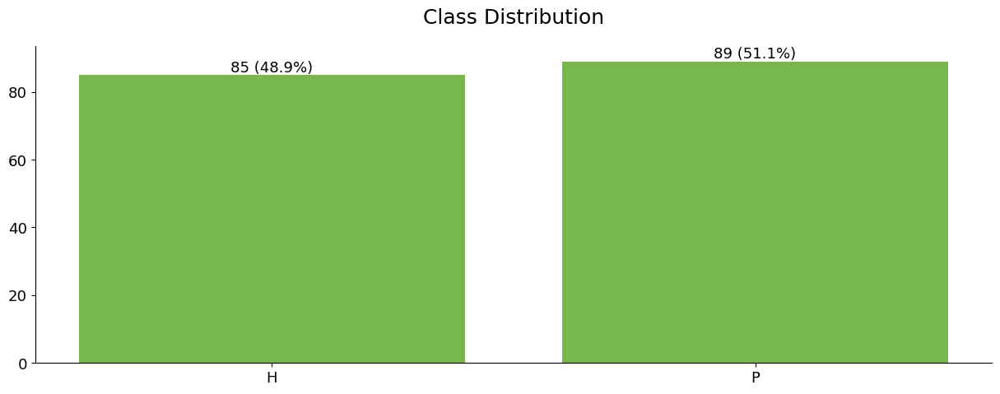

In [11]:
plt.figure(figsize=(15, 5))

data_analysis.class_dist(y, title="Class Distribution", colors=green_color, label_font_size=label_size)

plt.show()

In [12]:
numerical_columns_selector = selector(dtype_exclude=object)
categorical_columns_selector = selector(dtype_include=object)

numerical_columns = numerical_columns_selector(X)
categorical_columns = categorical_columns_selector(X)

In [13]:
from sklearn.compose import ColumnTransformer
print(f"Numerical Columns - {len(numerical_columns)}\n\n {numerical_columns}")
print(f"\n\n\nCategorical Columns - {len(categorical_columns)}\n\n {categorical_columns}")

Numerical Columns - 450

 ['air_time1', 'disp_index1', 'gmrt_in_air1', 'gmrt_on_paper1', 'max_x_extension1', 'max_y_extension1', 'mean_acc_in_air1', 'mean_acc_on_paper1', 'mean_gmrt1', 'mean_jerk_in_air1', 'mean_jerk_on_paper1', 'mean_speed_in_air1', 'mean_speed_on_paper1', 'num_of_pendown1', 'paper_time1', 'pressure_mean1', 'pressure_var1', 'total_time1', 'air_time2', 'disp_index2', 'gmrt_in_air2', 'gmrt_on_paper2', 'max_x_extension2', 'max_y_extension2', 'mean_acc_in_air2', 'mean_acc_on_paper2', 'mean_gmrt2', 'mean_jerk_in_air2', 'mean_jerk_on_paper2', 'mean_speed_in_air2', 'mean_speed_on_paper2', 'num_of_pendown2', 'paper_time2', 'pressure_mean2', 'pressure_var2', 'total_time2', 'air_time3', 'disp_index3', 'gmrt_in_air3', 'gmrt_on_paper3', 'max_x_extension3', 'max_y_extension3', 'mean_acc_in_air3', 'mean_acc_on_paper3', 'mean_gmrt3', 'mean_jerk_in_air3', 'mean_jerk_on_paper3', 'mean_speed_in_air3', 'mean_speed_on_paper3', 'num_of_pendown3', 'paper_time3', 'pressure_mean3', 'pressure

The only categorical column is 'ID' which has no relevance for classification because is just an identifier of each experiment, so it will be dropped

In [14]:
X = X.drop(columns=["ID"])
features_names = X.columns

In [15]:
# Convert from pandas to numpy and turn into a 1D array
y = y.to_numpy().ravel()
y = np.array([0 if x == 'H' else 1 for x in y])
y

array([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0])

In [16]:
sss_nsplits = 10
sss = StratifiedShuffleSplit(n_splits=sss_nsplits, test_size=0.2, random_state=42)

lr_clfs = []
lr_limes = []
lr_shaps = []
rf_clfs = []
rf_limes = []
rf_shaps = []
svm_clfs = []
svm_limes = []
svm_shaps = []
ebm_clfs = []

In [18]:
X_trains_pd = []
X_tests_pd = []
Y_trains = []
Y_tests = []

for i, (train_index, test_index) in enumerate(sss.split(X, y)):
    print(len(train_index), len(test_index))
    print(train_index, test_index)
    X_trains_pd.append(X.iloc[train_index])
    X_tests_pd.append(X.iloc[test_index])
    Y_trains.append(y[train_index])
    Y_tests.append(y[test_index])

139 35
[ 46  34   4  56  39 124 100  50  88  49  65 109  38  61  20  43  63  19
 102  44 127  14 155 106 129 137 115   5  42 117 161  72 141  26  33  52
 167 173 138  30  97 145  67  82 143 132 144  76  29  48   6 101  90  47
  86  57  81 156  75  32 130 169  58  68 166  21 118 123  35 162 164  18
  11  84  51 111 125 150  59  83  10  22  28  17  23  70 104   9  41 163
   7 126  74  69  93 147  77 160  15 152  27 120  53 133 171 158  91 134
 172 140  13 149 148 114  54  78 157 119 170 105  40  96  99  73  80 135
   2 122 116 128 142 110  85  37 159 113 107  95  66] [131  45 136  62  92 103 146 168  36  24 112 121  31  79   0  25 153   3
  94 139  60  55  16  71 108  64  12  87 154  89  98 151   8   1 165]
139 35
[107  55  74 147   8  88  80  30  87  16 127 101 150   6   5 136  27 161
 103 160 164  31  95  76 134  72  10 173  97 117  40 104  44 145 137 128
 142  90 154  11  81  59  38 120 156 110  45  78  43  21  22  94  77  39
  25  50 169 113 148  82  20  53 124 165  18 141 121  93 17

#### Instance to extract local explanations for all models

In [19]:
Exp_index = 3

# Classification

In [20]:
perf_analysis = PerformanceAnalysis()

## <i>Logistic Regression</i> (LR)

In [21]:
for i in range(sss_nsplits):
    lr_clf = LogisticRegression(solver="lbfgs", max_iter=500, C=0.01).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    lr_clfs.append(lr_clf)

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [22]:
for i in range(sss_nsplits):
    lr_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    lr_limes.append(lr_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [24]:
shap.initjs()

In [25]:
for i in range(sss_nsplits):
    lr_SHAP_exp = shap.KernelExplainer(lr_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    lr_shaps.append(lr_SHAP_exp)

## <i>Random Forest</i> (RF)

In [29]:
for i in range(sss_nsplits):
    rf_clf = RandomForestClassifier(n_estimators=100, bootstrap=False, max_features="log2").fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    rf_clfs.append(rf_clf)

### Extract Explanations 

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [31]:
for i in range(sss_nsplits):
    rf_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    rf_limes.append(rf_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [33]:
for i in range(sss_nsplits):
    rf_SHAP_exp = shap.Explainer(rf_clfs[i])
    rf_shaps.append(rf_SHAP_exp)

## <i> Support Vector Machines</i> (SVM)

In [37]:
for i in range(sss_nsplits):
    svm_clf = SVC(kernel="rbf", C=500, decision_function_shape="ovr", gamma="scale", probability=True).fit(X_trains_pd[i].to_numpy(), Y_trains[i])
    svm_clfs.append(svm_clf)

### Extract Explanations

#### Local

##### <i>Local Model-Agnostic Explanations</i> (LIME)

In [40]:
for i in range(sss_nsplits):
    svm_LIME_explainer = lime.lime_tabular.LimeTabularExplainer(X_trains_pd[i].to_numpy(), feature_names=features_names)
    svm_limes.append(svm_LIME_explainer)

##### <i>SHapley Additive exPlanations</i> (SHAP)

In [42]:
for i in range(sss_nsplits):
    svm_SHAP_exp = shap.KernelExplainer(svm_clfs[i].predict_proba, shap.sample(X_trains_pd[i], 20))
    svm_shaps.append(svm_SHAP_exp)

## <i>Explainable Boosting Machine</i> (EBM)

In [46]:
for i in range(sss_nsplits):
    ebm_clf = ExplainableBoostingClassifier(max_bins=1024, smoothing_rounds=500, cyclic_progress=0).fit(X_trains_pd[i], Y_trains[i])
    ebm_clfs.append(ebm_clf)

0
1
2
3
4
5
6
7
8
9


# Summary

In [50]:
visual = Visualization()

## Metrics

In [51]:
lr_cms = []
rf_cms = []
svm_cms = []
ebm_cms = []

lr_metrics_lst = []
rf_metrics_lst = []
svm_metrics_lst = []
ebm_metrics_lst = []

for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    lr_cm = confusion_matrix(Y_tests[i], lr_ye)
    
    lr_metrics = perf_analysis.compute_metrics(lr_cm)
    lr_metrics = lr_metrics.rename(columns={"Values": "LR"})
    lr_metrics["LR"] = [round(x, 2) for x in lr_metrics["LR"]]
    lr_metrics_lst.append(lr_metrics)
    lr_cms.append(lr_cm)
    
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_cm = confusion_matrix(Y_tests[i], rf_ye)
    rf_metrics = perf_analysis.compute_metrics(rf_cm)
    rf_metrics = rf_metrics.rename(columns={"Values": "RF"})
    rf_metrics["RF"] = [round(x, 2) for x in rf_metrics["RF"]]
    rf_metrics_lst.append(rf_metrics)
    rf_cms.append(rf_cm)

    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_cm = confusion_matrix(Y_tests[i], svm_ye)
    svm_metrics = perf_analysis.compute_metrics(svm_cm)
    svm_metrics = svm_metrics.rename(columns={"Values": "SVM"})
    svm_metrics["SVM"] = [round(x, 2) for x in svm_metrics["SVM"]]
    svm_metrics_lst.append(svm_metrics)
    svm_cms.append(svm_cm)

    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_cm = confusion_matrix(Y_tests[i], ebm_ye)
    ebm_metrics = perf_analysis.compute_metrics(ebm_cm)
    ebm_metrics = ebm_metrics.rename(columns={"Values": "EBM"})
    ebm_metrics["EBM"] = [round(x, 2) for x in ebm_metrics["EBM"]]
    ebm_metrics_lst.append(ebm_metrics)
    ebm_cms.append(ebm_cm)

    overall_metrics = pd.concat([lr_metrics, rf_metrics, svm_metrics, ebm_metrics], axis=1)
    display(overall_metrics)

Metrics,LR,RF,SVM,EBM
accuracy,0.86,0.97,0.89,0.94
false-positive rate,0.12,0.06,0.00,0.06
false-negative rate,0.17,0.00,0.22,0.06
precision,0.88,0.95,1.00,0.94
recall,0.83,1.00,0.78,0.94
f-score,0.86,0.97,0.88,0.94


Metrics,LR,RF,SVM,EBM
accuracy,0.83,0.86,0.86,0.91
false-positive rate,0.12,0.18,0.06,0.00
false-negative rate,0.22,0.11,0.22,0.17
precision,0.88,0.84,0.93,1.00
recall,0.78,0.89,0.78,0.83
f-score,0.82,0.86,0.85,0.91


Metrics,LR,RF,SVM,EBM
accuracy,0.86,0.91,0.80,0.94
false-positive rate,0.12,0.00,0.12,0.06
false-negative rate,0.17,0.17,0.28,0.06
precision,0.88,1.00,0.87,0.94
recall,0.83,0.83,0.72,0.94
f-score,0.86,0.91,0.79,0.94


Metrics,LR,RF,SVM,EBM
accuracy,0.80,0.89,0.77,0.86
false-positive rate,0.12,0.00,0.12,0.00
false-negative rate,0.28,0.22,0.33,0.28
precision,0.87,1.00,0.86,1.00
recall,0.72,0.78,0.67,0.72
f-score,0.79,0.88,0.75,0.84


Metrics,LR,RF,SVM,EBM
accuracy,0.63,0.91,0.63,0.91
false-positive rate,0.35,0.06,0.35,0.06
false-negative rate,0.39,0.11,0.39,0.11
precision,0.65,0.94,0.65,0.94
recall,0.61,0.89,0.61,0.89
f-score,0.63,0.91,0.63,0.91


Metrics,LR,RF,SVM,EBM
accuracy,0.83,0.97,0.89,0.97
false-positive rate,0.24,0.00,0.12,0.00
false-negative rate,0.11,0.06,0.11,0.06
precision,0.80,1.00,0.89,1.00
recall,0.89,0.94,0.89,0.94
f-score,0.84,0.97,0.89,0.97


Metrics,LR,RF,SVM,EBM
accuracy,0.89,0.91,0.89,0.91
false-positive rate,0.06,0.06,0.06,0.12
false-negative rate,0.17,0.11,0.17,0.06
precision,0.94,0.94,0.94,0.89
recall,0.83,0.89,0.83,0.94
f-score,0.88,0.91,0.88,0.92


Metrics,LR,RF,SVM,EBM
accuracy,0.86,0.94,0.91,0.91
false-positive rate,0.12,0.06,0.06,0.06
false-negative rate,0.17,0.06,0.11,0.11
precision,0.88,0.94,0.94,0.94
recall,0.83,0.94,0.89,0.89
f-score,0.86,0.94,0.91,0.91


Metrics,LR,RF,SVM,EBM
accuracy,0.69,0.83,0.71,0.86
false-positive rate,0.24,0.24,0.29,0.18
false-negative rate,0.39,0.11,0.28,0.11
precision,0.73,0.80,0.72,0.84
recall,0.61,0.89,0.72,0.89
f-score,0.67,0.84,0.72,0.86


Metrics,LR,RF,SVM,EBM
accuracy,0.83,0.89,0.83,0.86
false-positive rate,0.18,0.18,0.12,0.18
false-negative rate,0.17,0.06,0.22,0.11
precision,0.83,0.85,0.88,0.84
recall,0.83,0.94,0.78,0.89
f-score,0.83,0.89,0.82,0.86


In [52]:
lr_metrics_concat = pd.concat(tuple(lr_metrics_lst[:]), axis=1)
lr_means = lr_metrics_concat.mean(axis=1).to_frame()
lr_means = lr_means.rename(columns={0: "LR"})
lr_means["LR"] = [round(x, 2) for x in lr_means["LR"]]

In [53]:
lr_std = lr_metrics_concat.std(axis=1).to_frame()
lr_std = lr_std.rename(columns={0: "LR"})
lr_std["LR"] = [round(x, 2) for x in lr_std["LR"]]

In [54]:
rf_metrics_concat = pd.concat(tuple(rf_metrics_lst[:]), axis=1)
rf_means = rf_metrics_concat.mean(axis=1).to_frame()
rf_means = rf_means.rename(columns={0: "RF"})
rf_means["RF"] = [round(x, 2) for x in rf_means["RF"]]

In [55]:
rf_std = rf_metrics_concat.std(axis=1).to_frame()
rf_std = rf_std.rename(columns={0: "RF"})
rf_std["RF"] = [round(x, 2) for x in rf_std["RF"]]

In [56]:
svm_metrics_concat = pd.concat(tuple(svm_metrics_lst[:]), axis=1)
svm_means = svm_metrics_concat.mean(axis=1).to_frame()
svm_means = svm_means.rename(columns={0: "SVM"})
svm_means["SVM"] = [round(x, 2) for x in svm_means["SVM"]]

In [57]:
svm_std = svm_metrics_concat.std(axis=1).to_frame()
svm_std = svm_std.rename(columns={0: "SVM"})
svm_std["SVM"] = [round(x, 2) for x in svm_std["SVM"]]

In [58]:
ebm_metrics_concat = pd.concat(tuple(ebm_metrics_lst[:]), axis=1)
ebm_means = ebm_metrics_concat.mean(axis=1).to_frame()
ebm_means = ebm_means.rename(columns={0: "EBM"})
ebm_means["EBM"] = [round(x, 2) for x in ebm_means["EBM"]]

In [59]:
ebm_std = ebm_metrics_concat.std(axis=1).to_frame()
ebm_std = ebm_std.rename(columns={0: "EBM"})
ebm_std["EBM"] = [round(x, 2) for x in ebm_std["EBM"]]

### Mean of obtained metrics

In [60]:
overall_metrics_means = pd.concat([lr_means, rf_means, svm_means, ebm_means], axis=1)
display(overall_metrics_means)

,LR,RF,SVM,EBM
accuracy,0.81,0.91,0.82,0.91
false-positive rate,0.17,0.08,0.13,0.07
false-negative rate,0.22,0.10,0.23,0.11
precision,0.83,0.93,0.87,0.93
recall,0.78,0.90,0.77,0.89
f-score,0.80,0.91,0.81,0.91


### Standard Deviation of obtained metrics

In [61]:
overall_metrics_std = pd.concat([lr_std, rf_std, svm_std, ebm_std], axis=1)
display(overall_metrics_std)

,LR,RF,SVM,EBM
accuracy,0.08,0.04,0.09,0.04
false-positive rate,0.09,0.09,0.11,0.07
false-negative rate,0.10,0.06,0.09,0.07
precision,0.09,0.07,0.11,0.06
recall,0.10,0.06,0.09,0.07
f-score,0.09,0.04,0.09,0.04


#### Save means in disk

In [62]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [63]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = i
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_means.txt", "w") as text_file:
    print(latex_str, file=text_file)

#### Save standard deviations in disk

In [64]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_std.columns]) + " \\\ \n"

In [65]:
for i, row in overall_metrics_std.iterrows():
    
    aux_str = i
    for k in row:
        aux_str += f" & {k}"
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_std.txt", "w") as text_file:
    print(latex_str, file=text_file)

#### Save means with std in disk

In [224]:
latex_str = "Metrics"  + ''.join([" & " + x for x in overall_metrics_means.columns]) + " \\\ \n"

In [225]:
for i, row in overall_metrics_means.iterrows():
    
    aux_str = i
    
    cont = 0
    for k in row:
        aux_str += f" & {k} \\textpm{overall_metrics_std.loc[[i]].iloc[0].iloc[cont]}"
        cont += 1
    
    latex_str += aux_str + " \\\ \n"

with open(f"{logs_dir}/darwin_metrics_means_wstd.txt", "w") as text_file:
    print(latex_str, file=text_file)

## Confusion Matrices

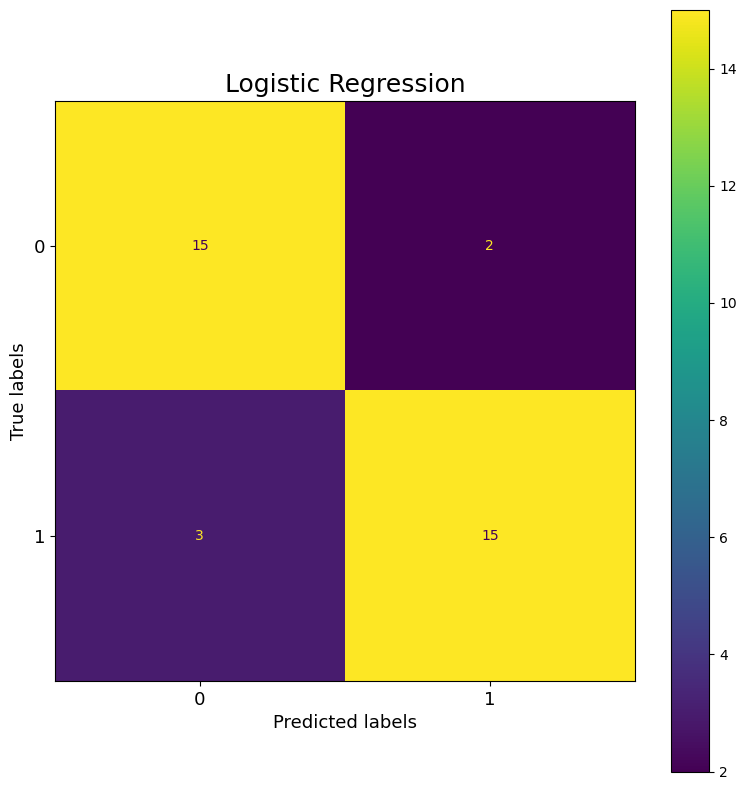

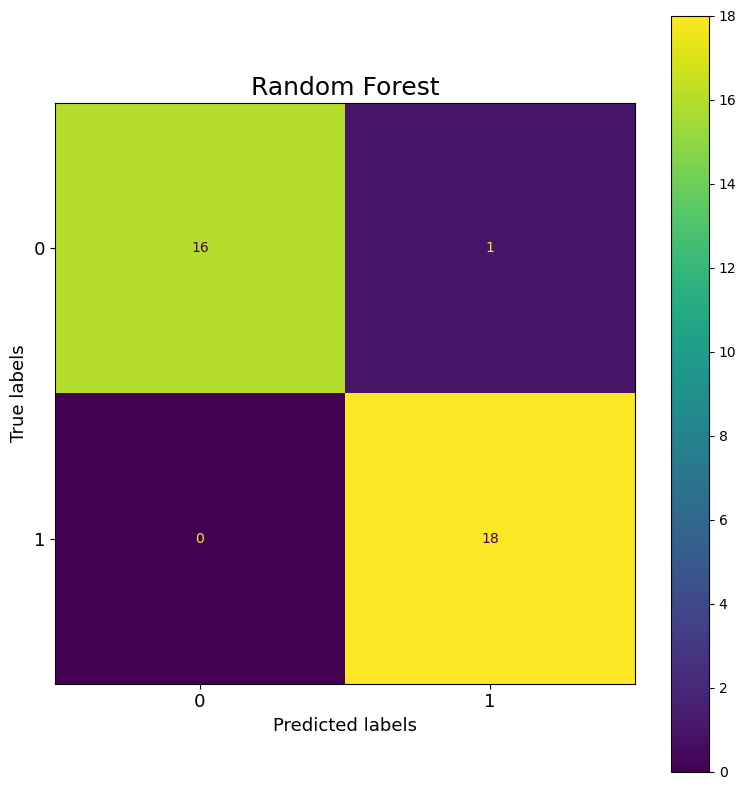

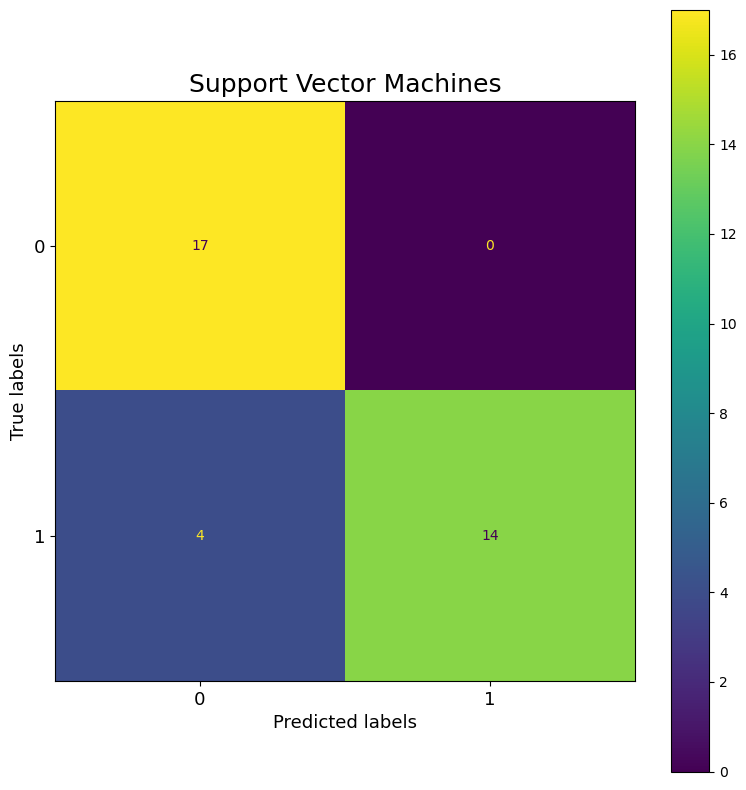

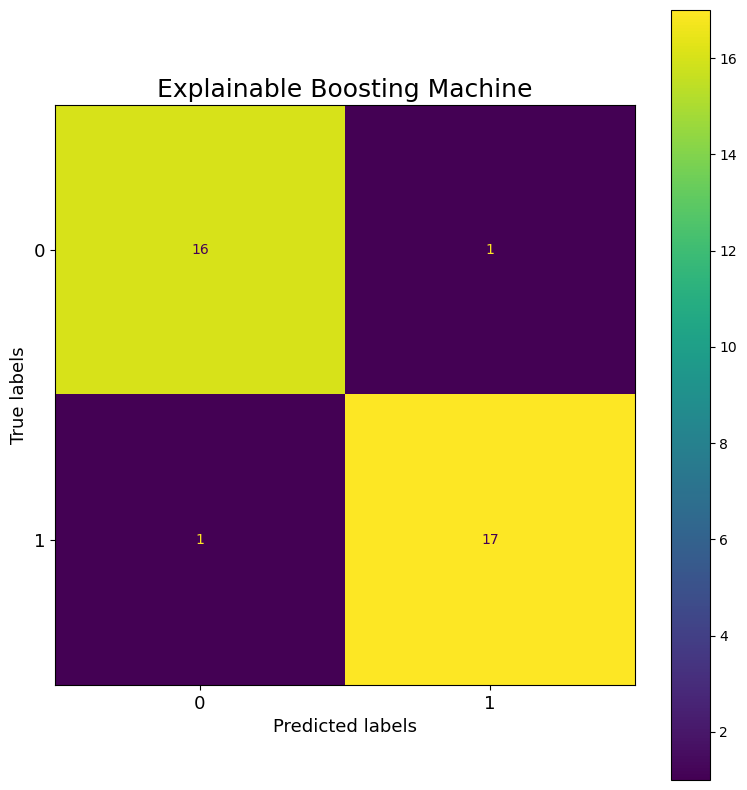

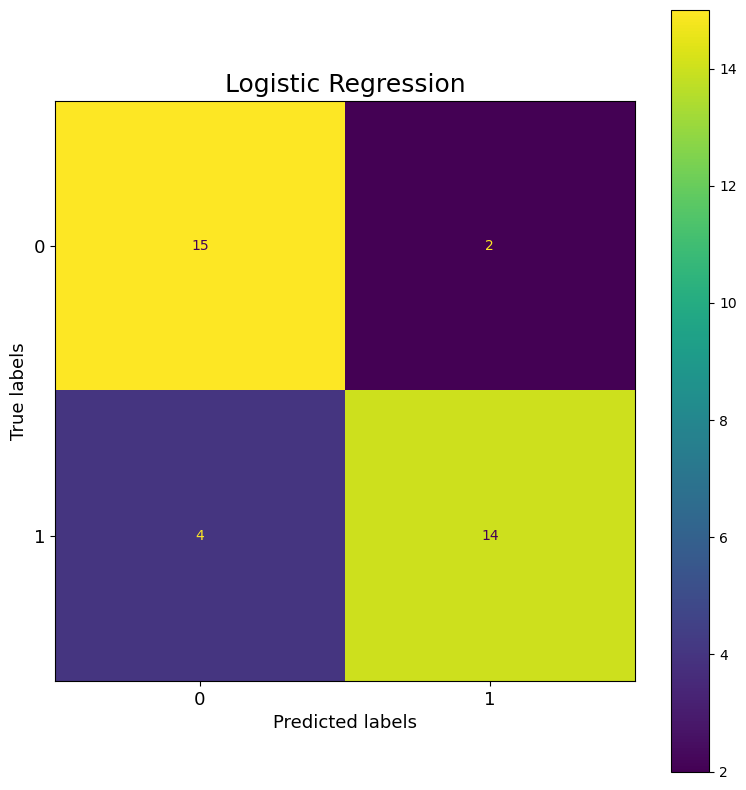

...

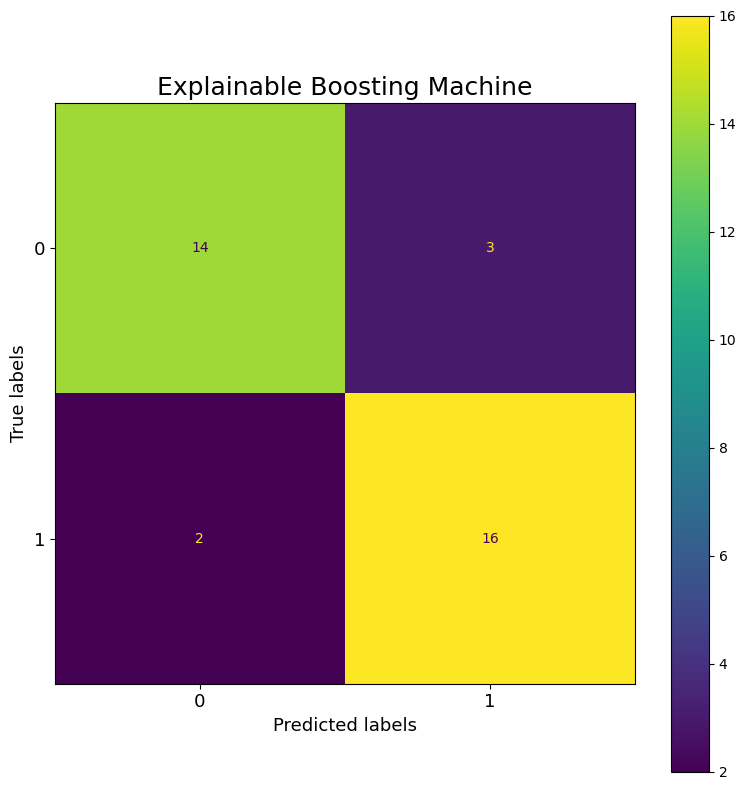

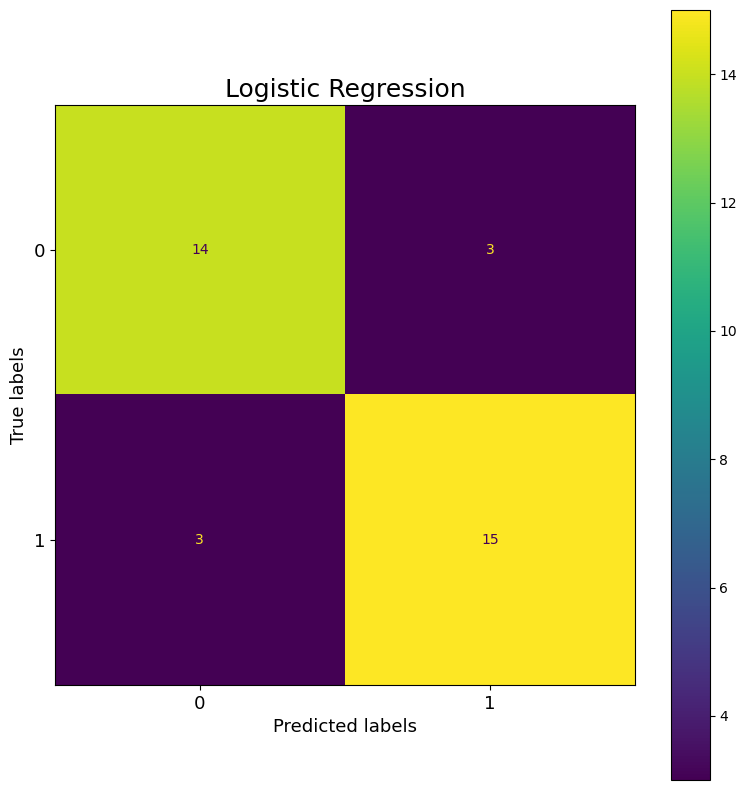

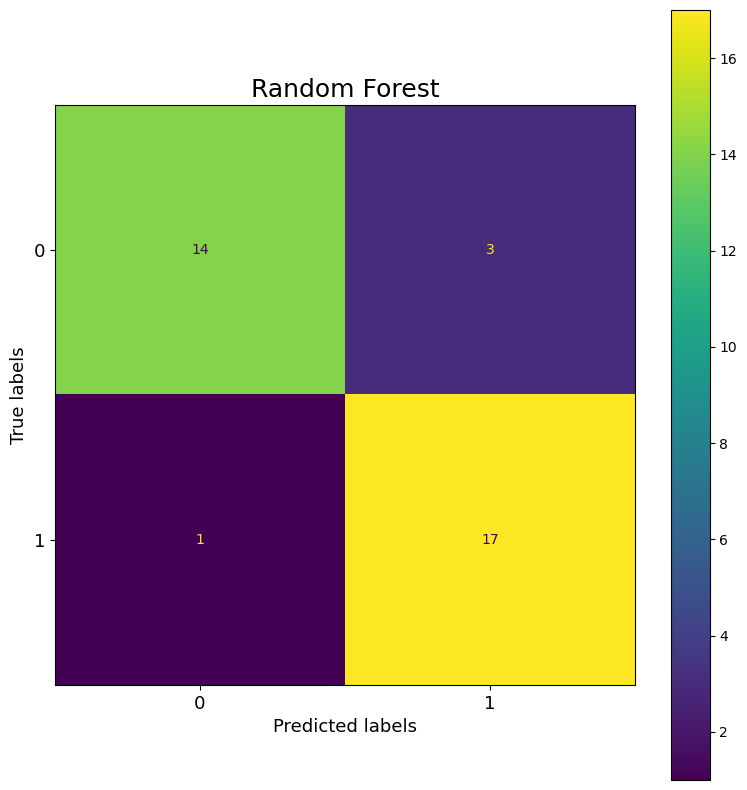

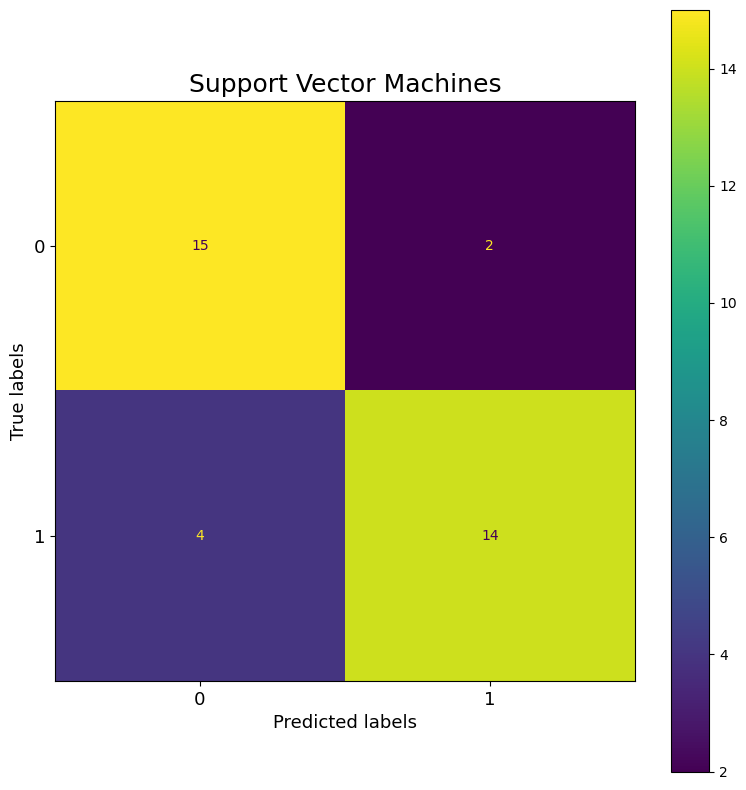

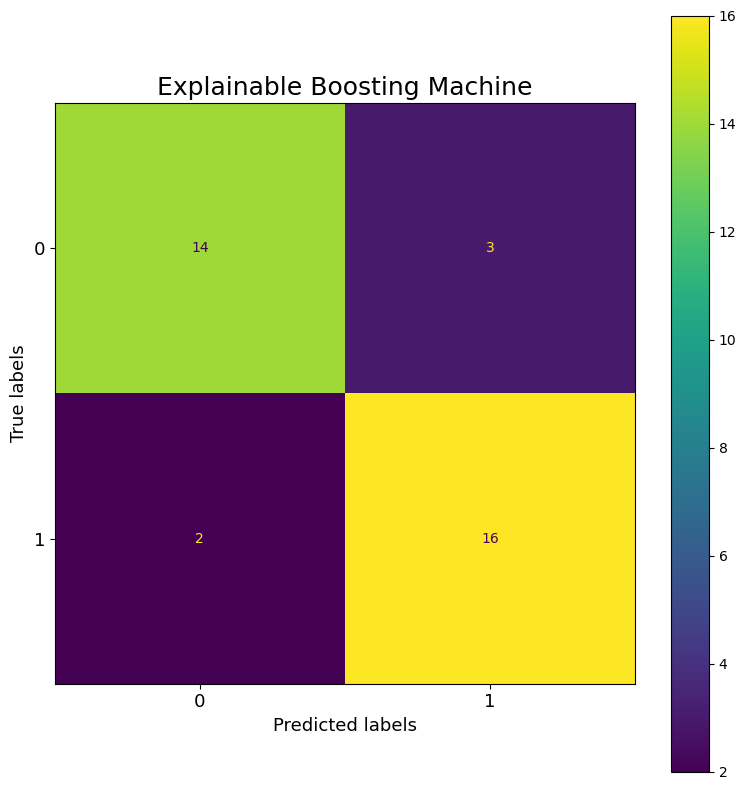

In [66]:
for i in range(sss_nsplits):
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    visual.confusion_matrices_pred([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], 
                              [lr_ye, rf_ye, svm_ye, ebm_ye],
                              nrows=2, 
                              ncols=2, 
                              figsize=(8, 8),
                              title_size=title_size,
                              label_size=label_size,
                              titles=["Logistic Regression", "Random Forest", "Support Vector Machines", "Explainable Boosting Machine"],
                              save_name=f"{logs_dir}/darwin_conf_matrices_{i}"
                              )
    
    # plt.savefig(f"{logs_dir}/darwin_conf_matrices_95.png", bbox_inches="tight")
    
    plt.show()

## Curves

[[15  2]
 [ 3 15]]


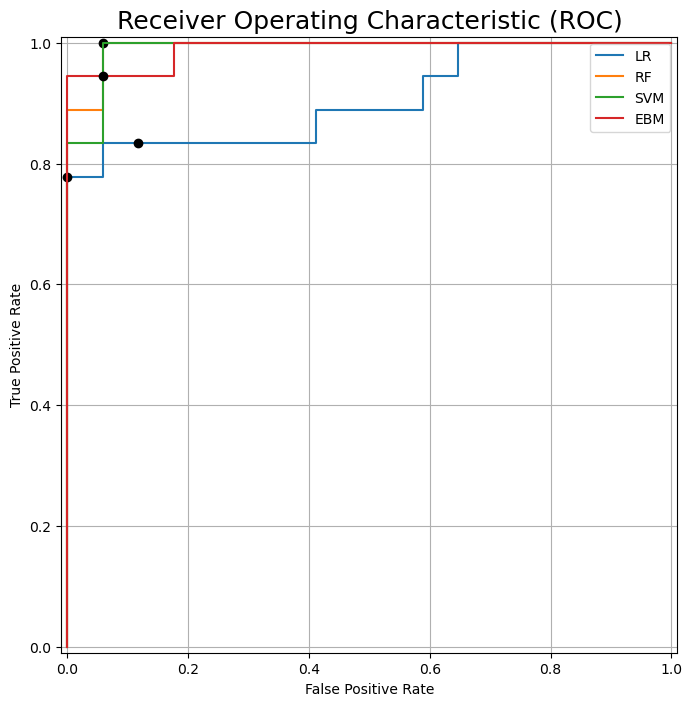

[[15  2]
 [ 4 14]]


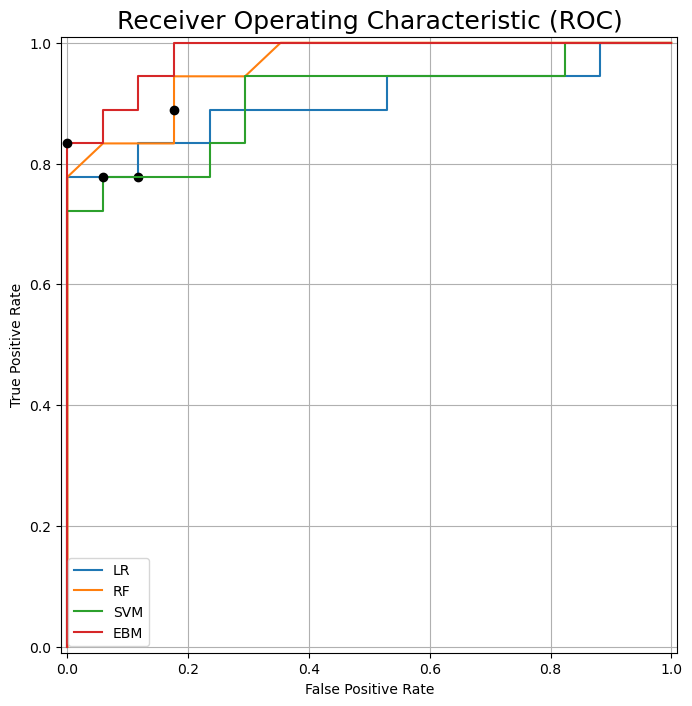

[[15  2]
 [ 3 15]]


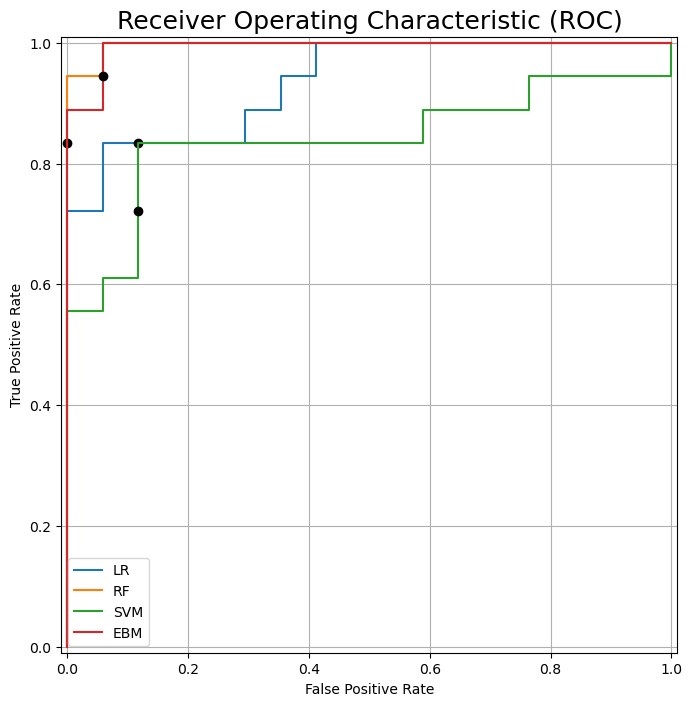

[[15  2]
 [ 5 13]]


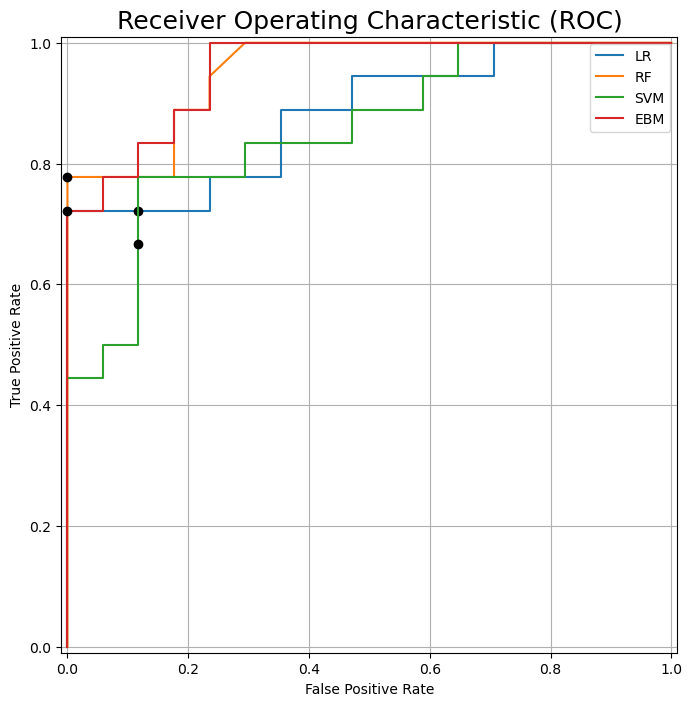

[[11  6]
 [ 7 11]]


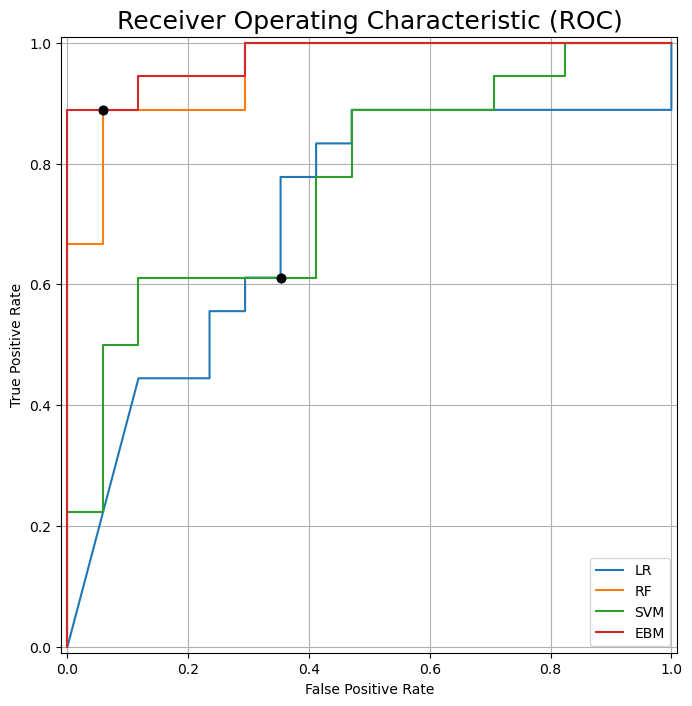

[[13  4]
 [ 2 16]]


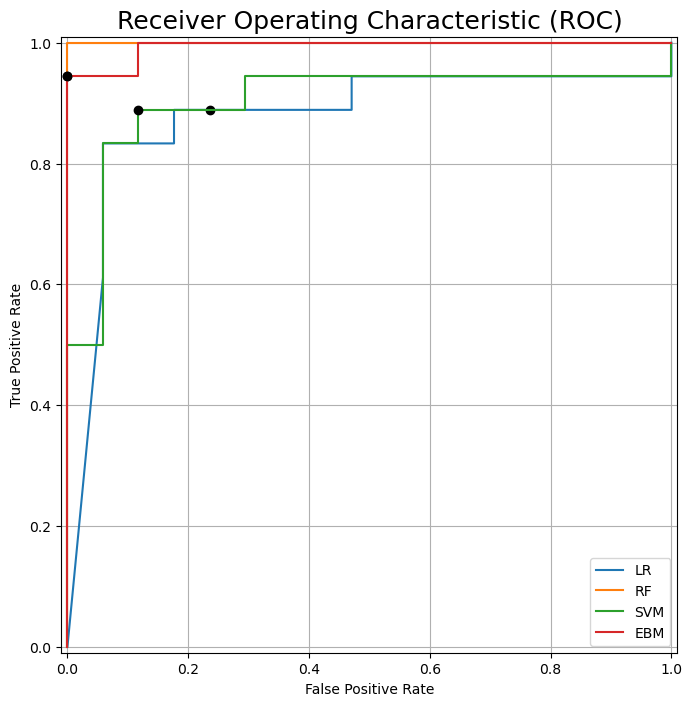

[[16  1]
 [ 3 15]]


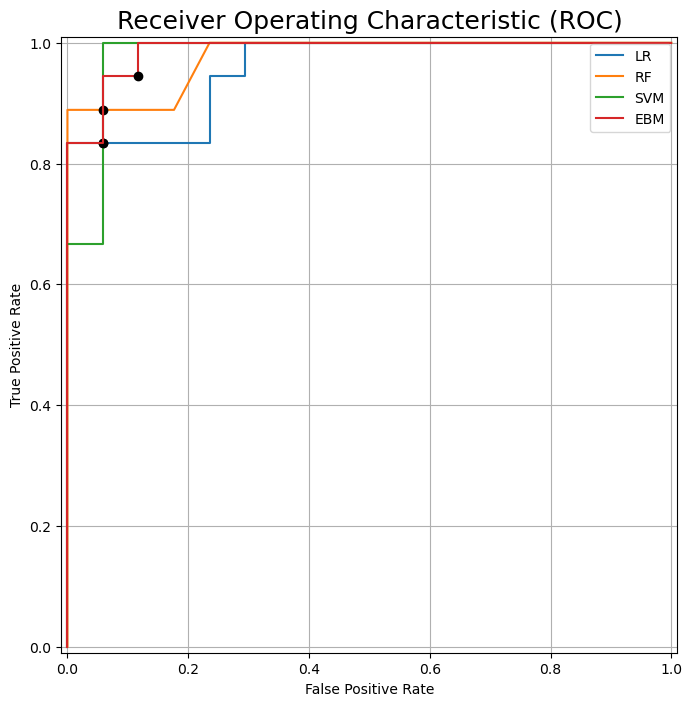

[[15  2]
 [ 3 15]]


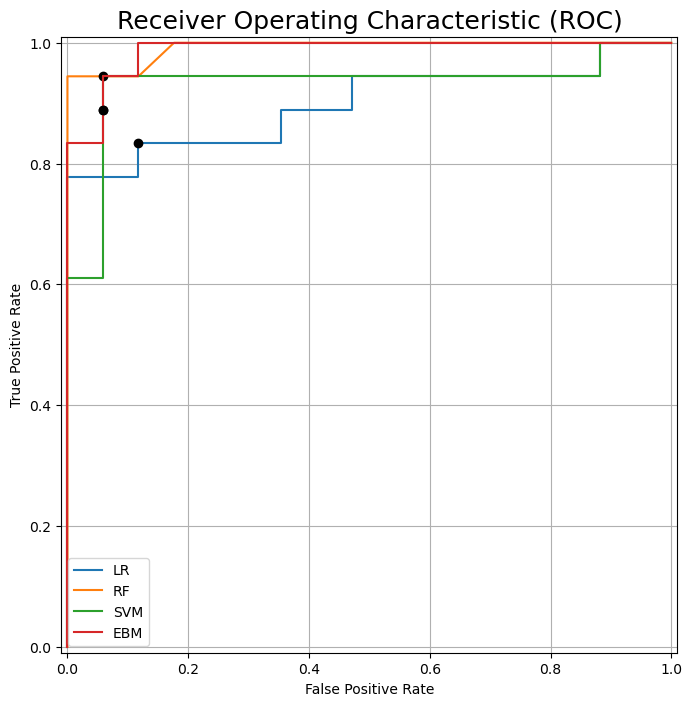

[[13  4]
 [ 7 11]]


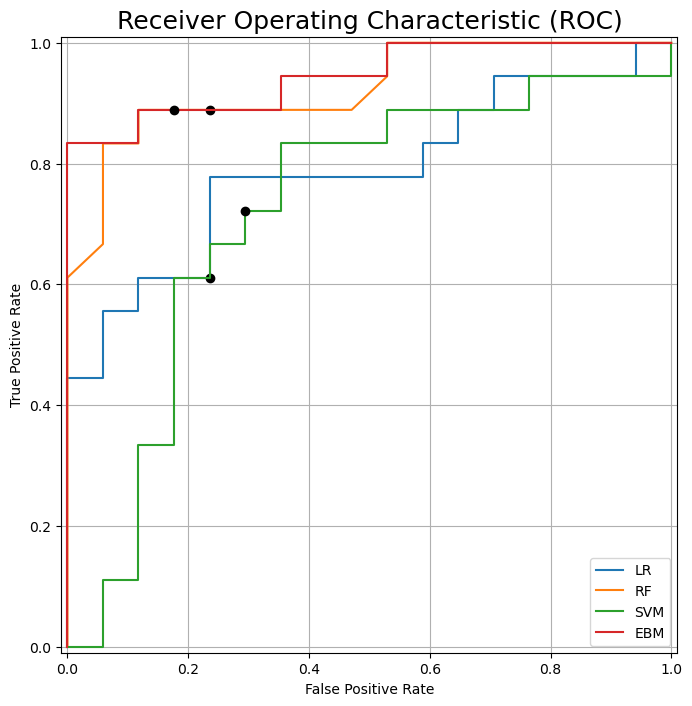

[[14  3]
 [ 3 15]]


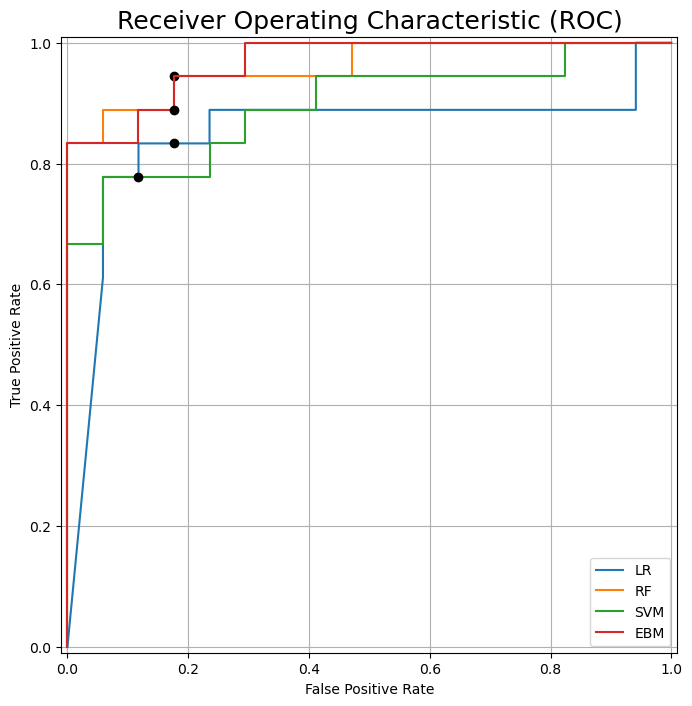

In [67]:
for i in range(sss_nsplits):
    plt.figure(figsize=(8, 8))
    lr_ye = lr_clfs[i].predict(X_tests_pd[i].to_numpy())
    rf_ye = rf_clfs[i].predict(X_tests_pd[i].to_numpy())
    svm_ye = svm_clfs[i].predict(X_tests_pd[i].to_numpy())
    ebm_ye = ebm_clfs[i].predict(X_tests_pd[i].to_numpy())
    
    lr_cm = lr_cms[i]
    rf_cm = rf_cms[i]
    svm_cm = svm_cms[i]
    ebm_cm = ebm_cms[i]
    
    print(lr_cm)
    
    lr_y2d = lr_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    rf_y2d = rf_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    svm_y2d = svm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    ebm_y2d = ebm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    
    perf_analysis.compare_ROC([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
    
    plt.savefig(f"{logs_dir}/darwin_ROC_{i}.png", bbox_inches="tight")
    
    plt.show()

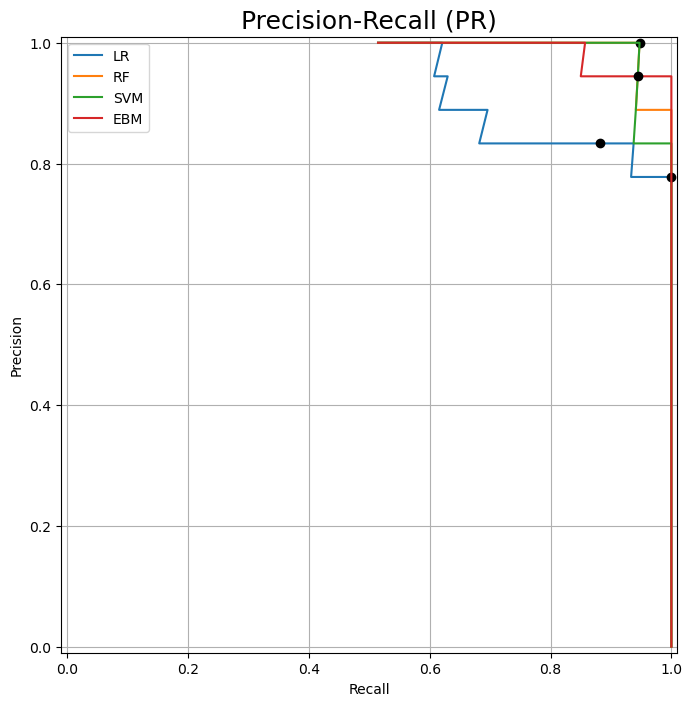

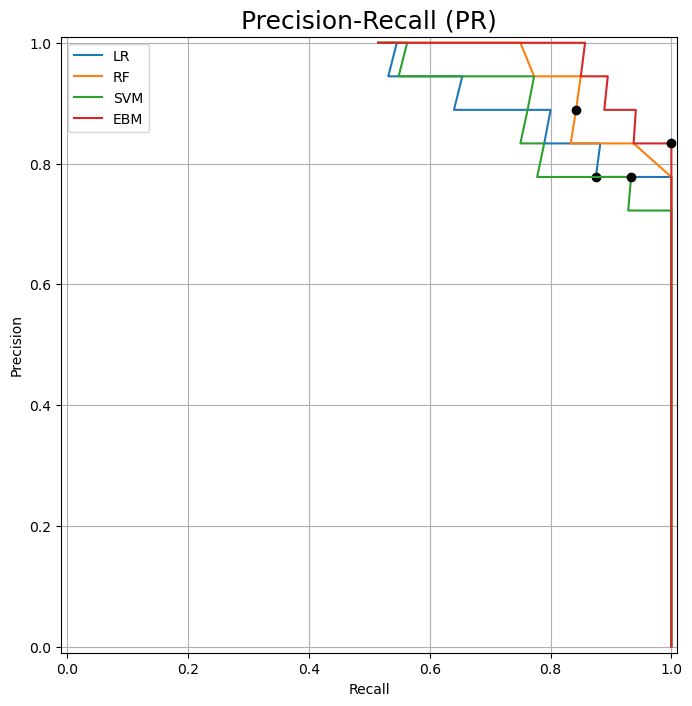

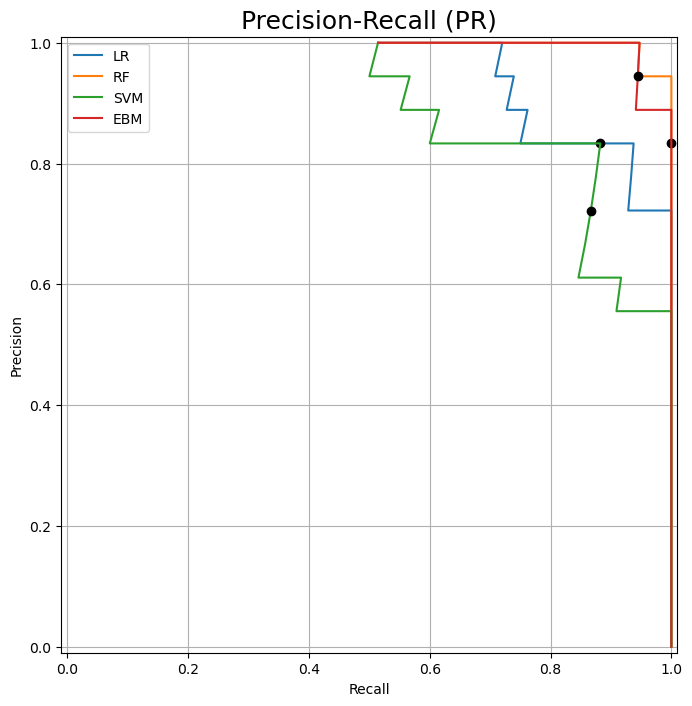

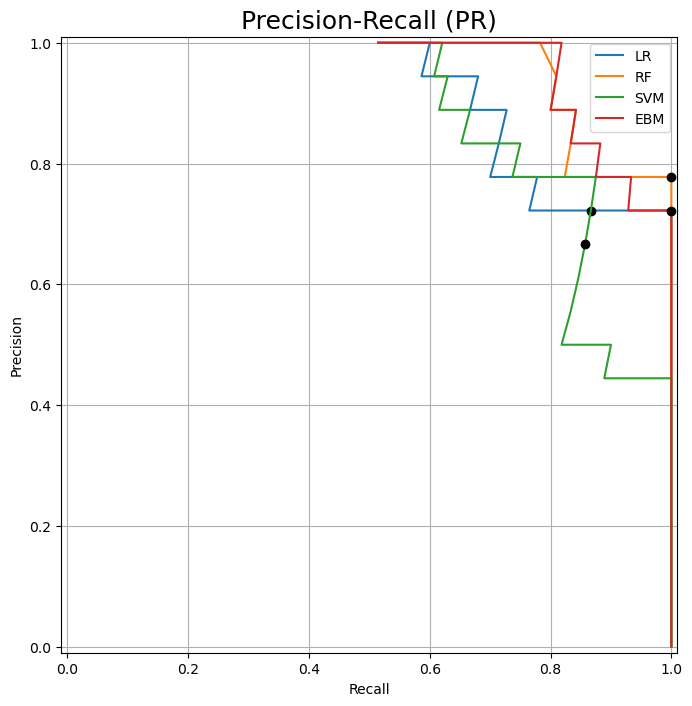

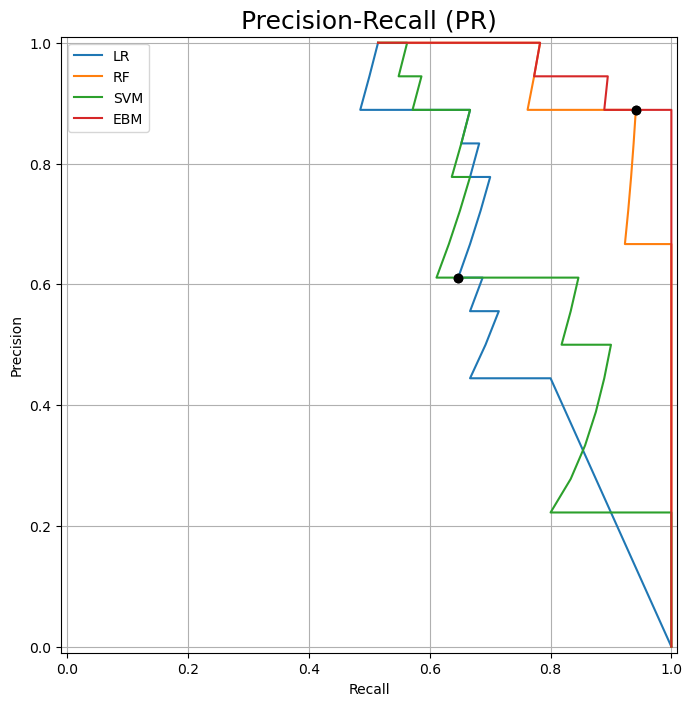

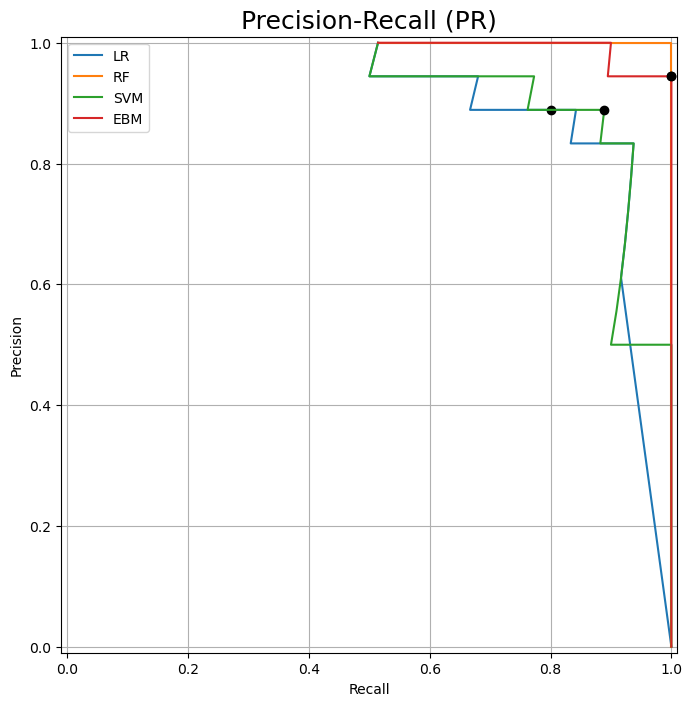

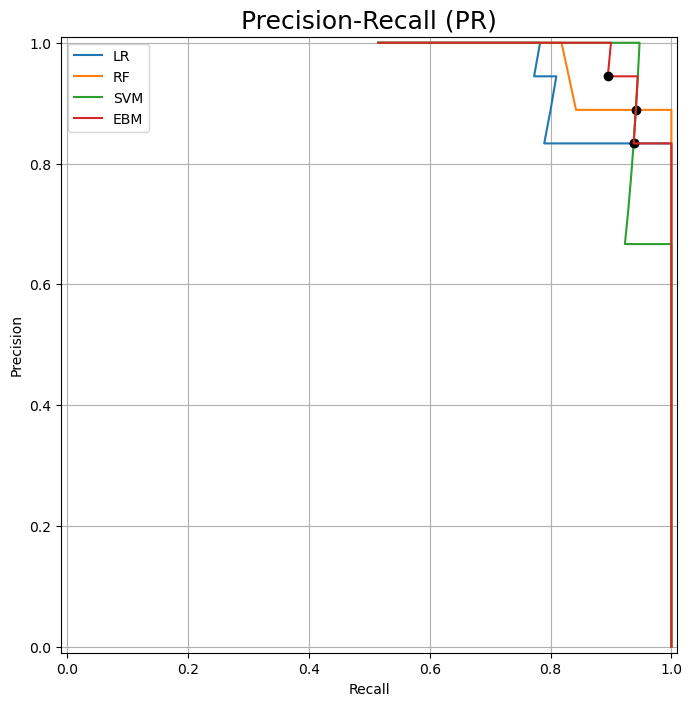

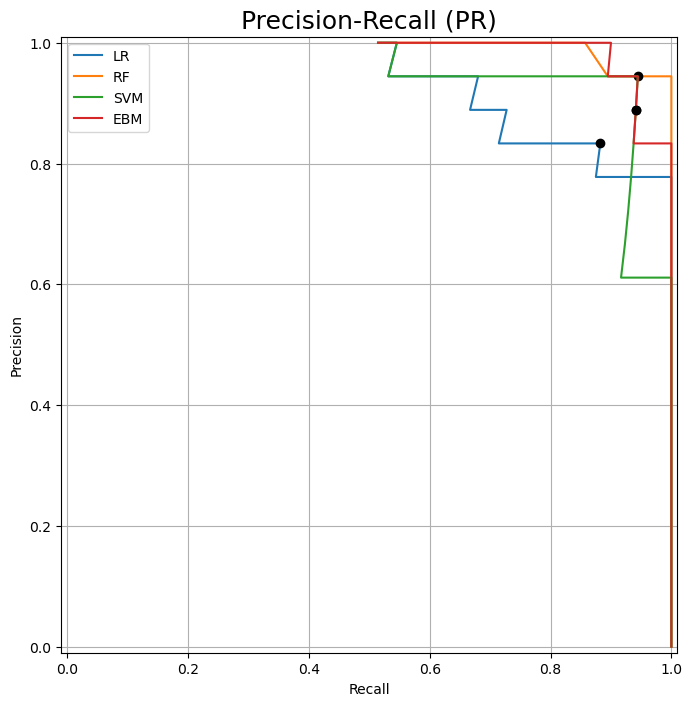

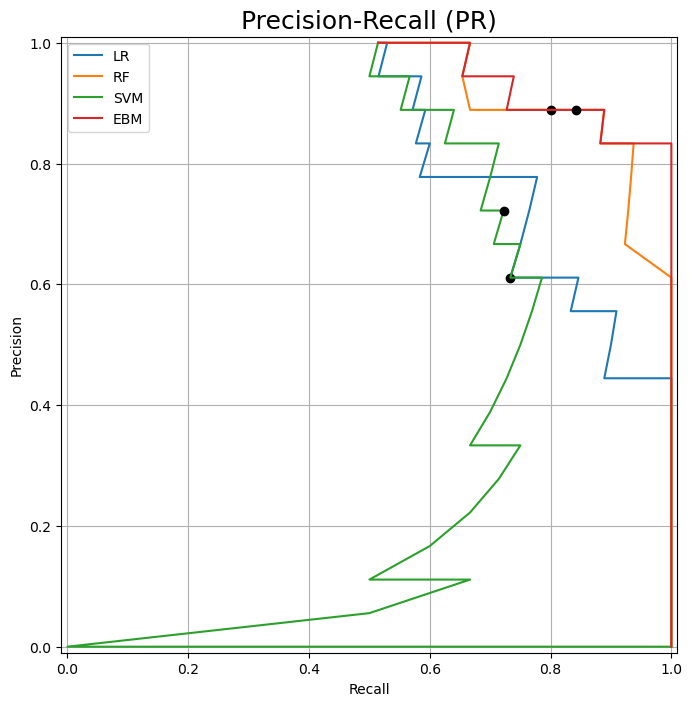

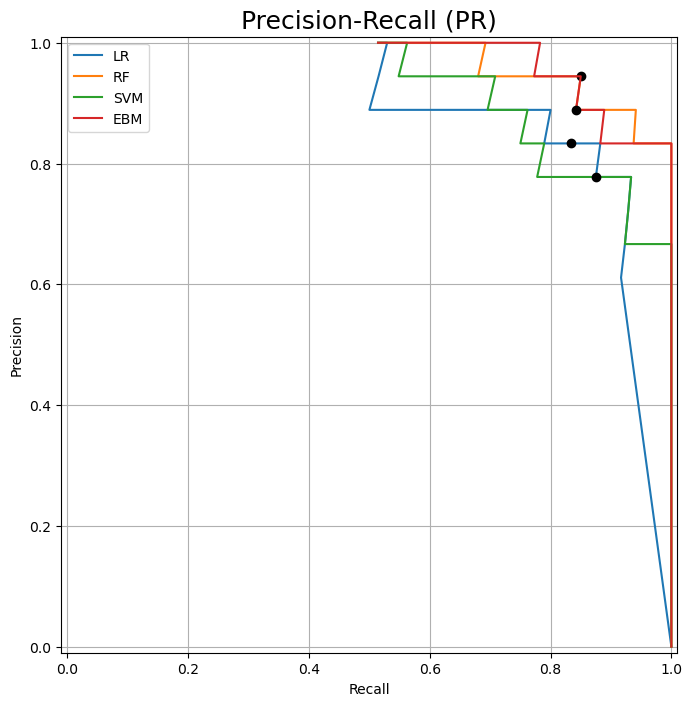

In [68]:
for i in range(sss_nsplits):
    plt.figure(figsize=(8, 8))
    
    lr_cm = lr_cms[i]
    rf_cm = rf_cms[i]
    svm_cm = svm_cms[i]
    ebm_cm = ebm_cms[i]
    
    lr_y2d = lr_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    rf_y2d = rf_clfs[i].predict_proba(X_tests_pd[i].to_numpy())[:, 1]
    svm_y2d = svm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    ebm_y2d = ebm_clfs[i].decision_function(X_tests_pd[i].to_numpy())
    
    perf_analysis.compare_PR([Y_tests[i], Y_tests[i], Y_tests[i], Y_tests[i]], [lr_cm, rf_cm, svm_cm, ebm_cm], [lr_y2d, rf_y2d, svm_y2d, ebm_y2d], ["LR","RF", "SVM", "EBM"])
    
    plt.savefig(f"{logs_dir}/darwin_PR_{i}.png", bbox_inches="tight")
    
    plt.show()

## Local Explanations

### LIME

In [69]:
for i in range(sss_nsplits):
    lr_LIME_explanation = lr_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], lr_clfs[i].predict_proba)
    lr_LIME_explanation.show_in_notebook(show_table=True)
    lr_LIME_explanation.save_to_file(f"{logs_dir}/darwin_LR_LIME_{i}.html")

In [70]:
for i in range(sss_nsplits):
    rf_LIME_explanation = rf_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], rf_clfs[i].predict_proba)
    rf_LIME_explanation.show_in_notebook(show_table=True)
    rf_LIME_explanation.save_to_file(f"{logs_dir}/darwin_RF_LIME_{i}.html")

In [71]:
for i in range(sss_nsplits):
    svm_LIME_explanation = svm_limes[i].explain_instance(X_tests_pd[i].to_numpy()[Exp_index], svm_clfs[i].predict_proba)
    svm_LIME_explanation.show_in_notebook(show_table=True)
    svm_LIME_explanation.save_to_file(f"{logs_dir}/darwin_SVM_LIME_{i}.html")

### SHAP & EBM

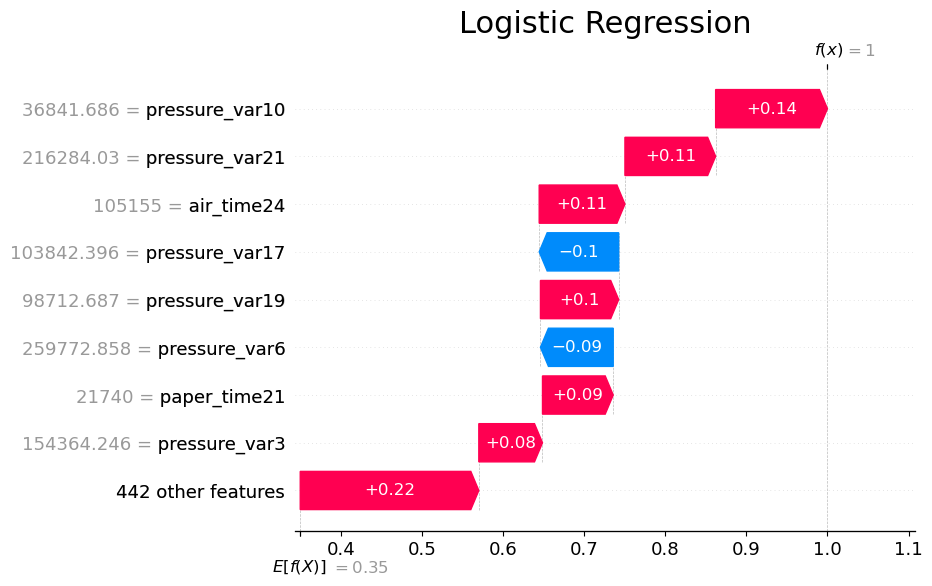

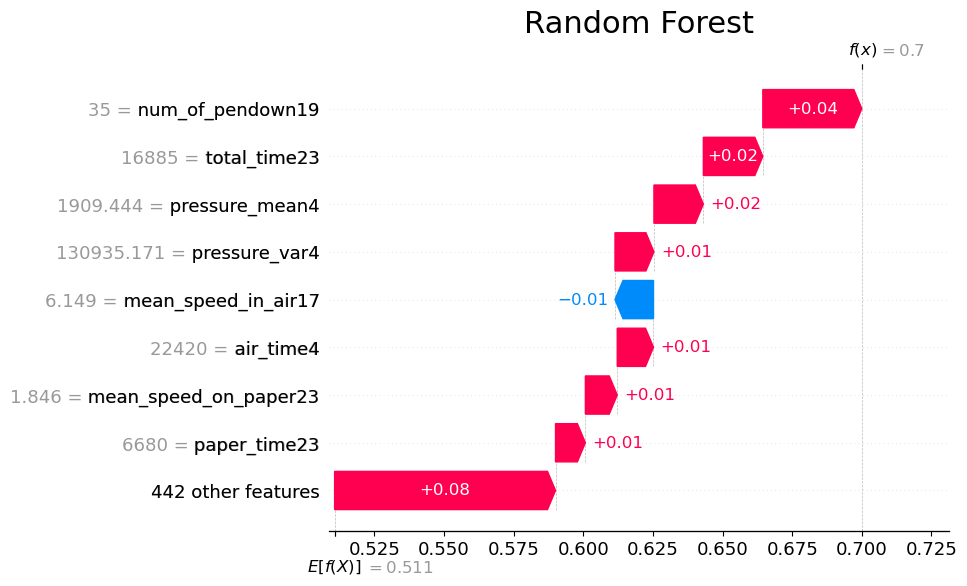

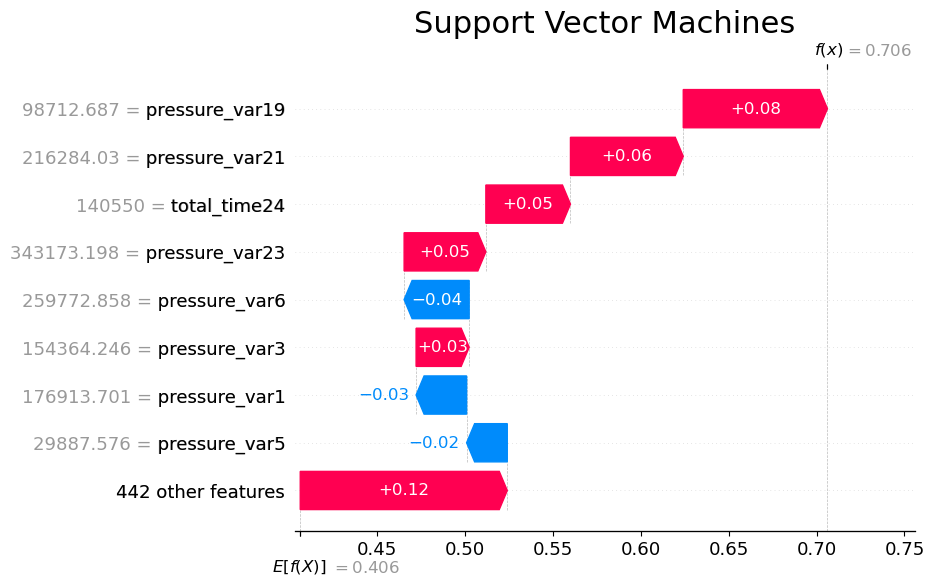

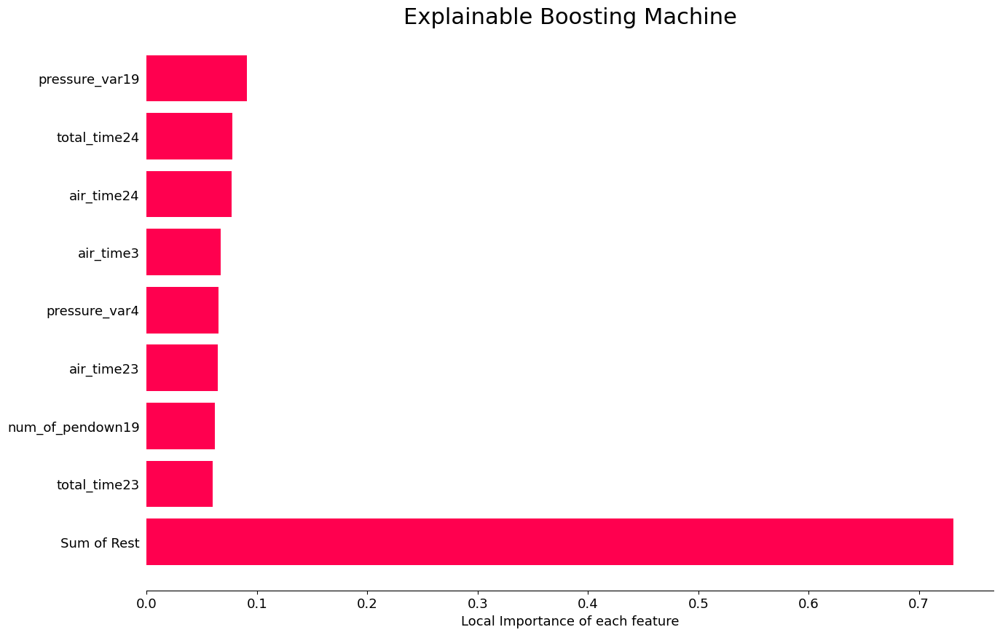

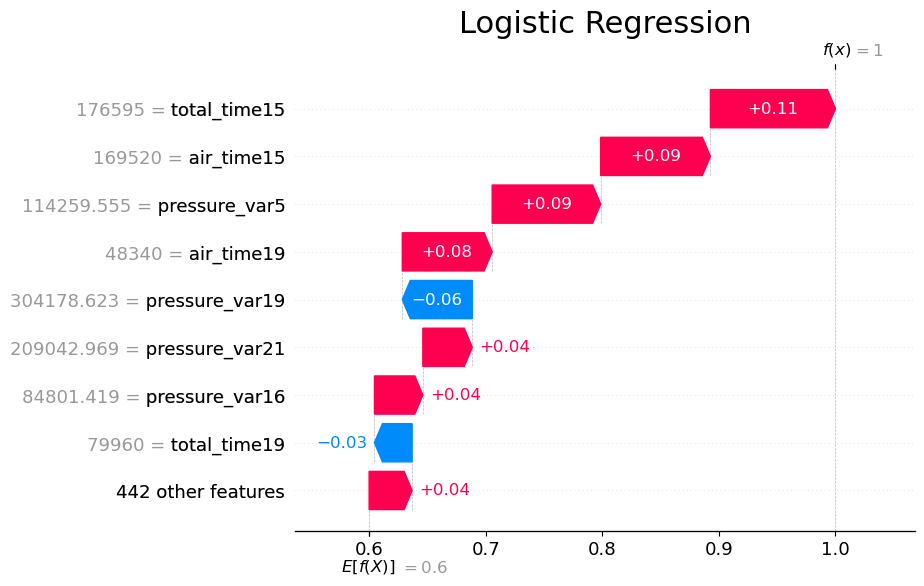

...

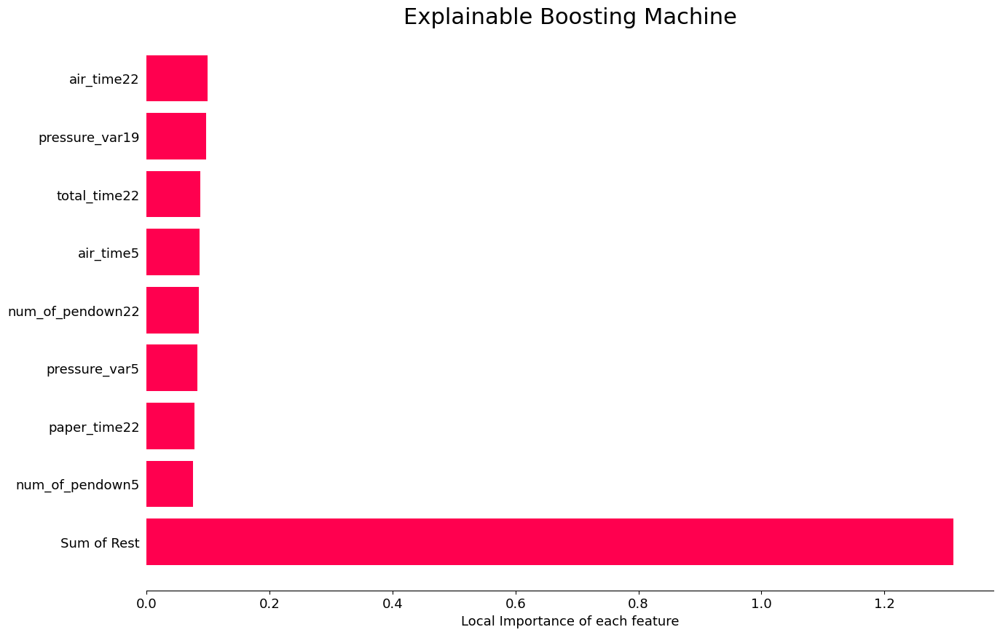

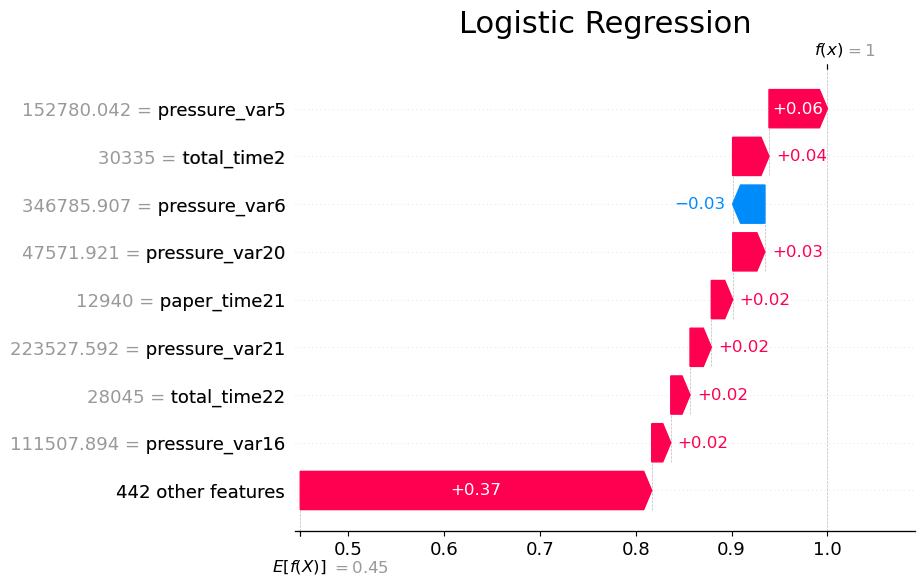

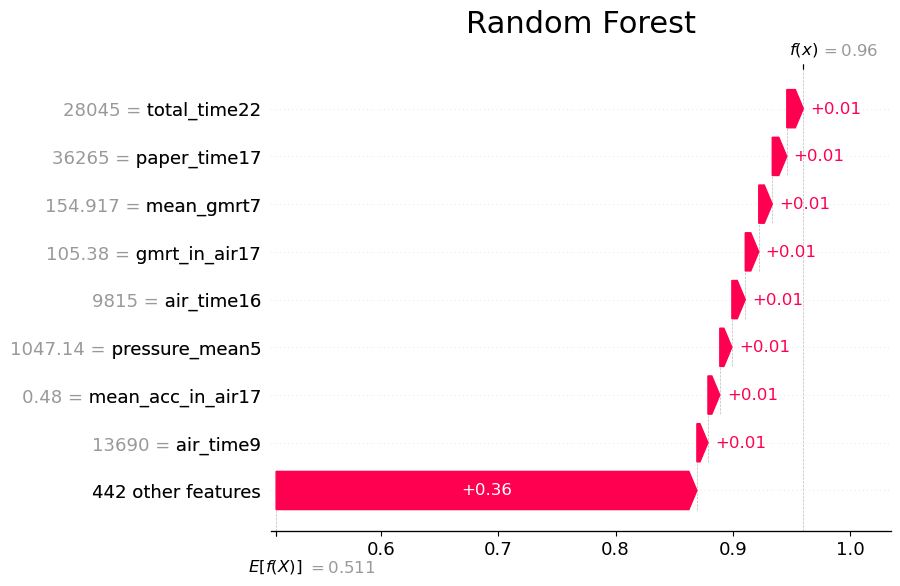

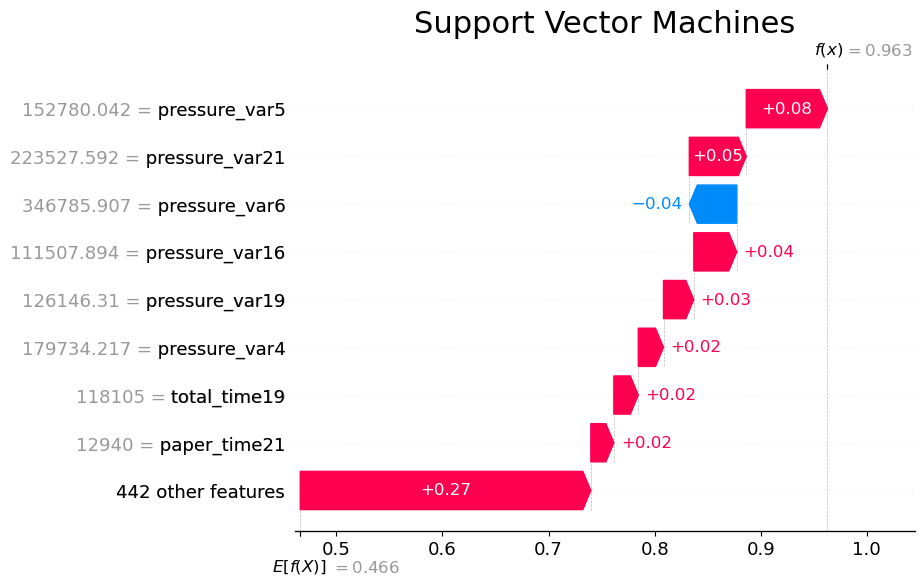

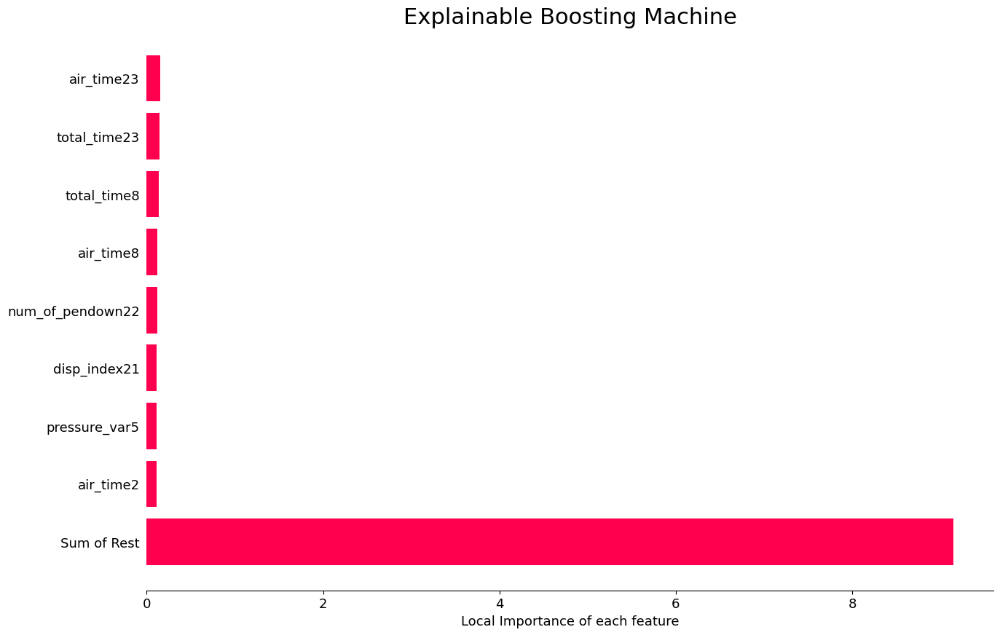

In [ ]:
for i in range(sss_nsplits):
    Exp_inst_pd = X_tests_pd[i].iloc[Exp_index]
    
    lr_shap_loc_values = np.array(lr_shaps[i].shap_values(Exp_inst_pd))
    rf_shap_loc_values = np.array(rf_shaps[i].shap_values(Exp_inst_pd))
    svm_shap_loc_values = np.array(svm_shaps[i].shap_values(Exp_inst_pd))
    
    explanations = [shap.Explanation(lr_shap_loc_values[1, :], lr_shaps[i].expected_value[1], data=Exp_inst_pd),
                shap.Explanation(rf_shap_loc_values[1, :], rf_shaps[i].expected_value[1], data=Exp_inst_pd),
                shap.Explanation(svm_shap_loc_values[1, :], svm_shaps[i].expected_value[1], data=Exp_inst_pd)]
    
    ebm_local = ebm_clfs[i].explain_local(X_tests_pd[i], Y_tests[i])
    
    visual.local_shap(explanations, 
                      ebm_local.data(key=Exp_index),
                      nrows = 2,
                      ncols = 2,
                      figsize = (15,10),
                      title_size = 22,
                      label_size = label_size,
                      titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                      ebm_colors = shap_colors / 255,
                      num_features=9,
                      save_name=f"{logs_dir}/darwin_local_SHAP_EBM_{i}")
    
    plt.show()


## Global Explanations

In [ ]:
for i in range(sss_nsplits):
    lr_shap_global_values = lr_shaps[i].shap_values(X_tests_pd[i])
    rf_shap_global_values = rf_shaps[i].shap_values(X_tests_pd[i])
    svm_shap_global_values = svm_shaps[i].shap_values(X_tests_pd[i])
    
    global_shap_values = [lr_shap_global_values,
                      rf_shap_global_values,
                      svm_shap_global_values]
    
    ebm_global = ebm_clfs[i].explain_global()

    visual.global_shap(global_shap_values,
                       X_tests_pd[i],
                       ebm_global.data(),
                       nrows = 2,
                       ncols = 2,
                       figsize = (15, 10),
                       title_size = 30,
                       label_size = 15,
                       titles = ["Logistic Regression", "Random Forest", "Support Vector Machines"],
                       ebm_colors = shap_colors/255,
                       num_features=15,
                       save_name=f"{logs_dir}/darwin_global_SHAP_EBM_{i}")
    
    plt.show()